In [337]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt

In [352]:
def compute_border_thresholds(image, border_size=20):
    # Extract the border regions (top, bottom, left, right edges)
    top_border = image[:border_size, :]
    bottom_border = image[-border_size:, :]
    left_border = image[:, :border_size]
    right_border = image[:, -border_size:]

    # Combine all border pixels into one array
    border_pixels = np.concatenate((top_border.flatten(), 
                                    bottom_border.flatten(), 
                                    left_border.flatten(), 
                                    right_border.flatten()))

    # Calculate the mean and standard deviation of the border pixel values
    mean_intensity = np.mean(border_pixels)
    std_intensity = np.std(border_pixels)

    # Set thresholds based on the border statistics
    threshold1 = mean_intensity - std_intensity
    threshold2 = mean_intensity + std_intensity

    return threshold1, threshold2

In [353]:
# Function to perform edge detection using Canny
def compute_edges(image):
    # Convert to grayscale if necessary
    if len(image.shape) == 3:
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    else:
        gray = image

    # Compute adaptive thresholds from the border
    threshold1, threshold2 = compute_border_thresholds(image)
    threshold1 = 100
    threshold2 = 200
    
    # Apply Canny edge detection
    edges = cv2.Canny(gray, threshold1, threshold2, apertureSize=3)
    
    return edges


In [354]:
def morphological_transformations(edges):
    # Perform morphological closing to fill gaps in the edges
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (27, 27))  # Use a kernel size of your choice
    closed = cv2.dilate(edges, kernel, iterations=1)

    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (17, 17))  # Use a kernel size of your choice
    opened = cv2.erode(closed, kernel, iterations=1)

    return opened

In [355]:
def fill_artworks_with_convex_hull(edges):

    # Find contours of the closed image
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Take the two largest contours
    contours = sorted(contours, key=cv2.contourArea, reverse=True)[:2]

    # Create an empty mask to draw filled convex hulls
    mask = np.zeros_like(edges)

    # Fill the convex hulls of the contours
    for contour in contours:
        if contour.size > 0:  # Ensure the contour is valid
            convex_hull = cv2.convexHull(contour)
            cv2.drawContours(mask, [convex_hull], -1, 255, thickness=cv2.FILLED)

    return mask, contours

In [361]:
def remove_small_segments(mask, min_area=1000):
    """
    Removes small segmented areas from a binary mask based on a minimum area threshold.
    
    Parameters:
        mask (ndarray): Binary mask where segmented areas are white (255) and background is black (0).
        min_area (int): Minimum area (in pixels) to keep. Components smaller than this will be removed.
    
    Returns:
        ndarray: Cleaned binary mask with small components removed.
    """
    # Label connected components in the mask
    num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(mask, connectivity=8)

    # Create an empty mask to store the cleaned result
    cleaned_mask = np.zeros(mask.shape, dtype=np.uint8)

    # Iterate through each component and keep only those with area above the threshold
    for i in range(1, num_labels):  # Skip label 0 as it is the background
        area = stats[i, cv2.CC_STAT_AREA]
        if area >= min_area:
            # Retain the component in the cleaned mask
            cleaned_mask[labels == i] = 255

    return cleaned_mask

In [362]:
def process_directory_images(directory_path):
    for filename in os.listdir(directory_path):
        image_path = os.path.join(directory_path, filename)
        
        if filename.lower().endswith('.jpg'):
            image = cv2.imread(image_path)

            if image is None:
                print(f"Failed to load image at {image_path}")
                continue

            edges = compute_edges(image)

            closed = morphological_transformations(edges)

            mask, contours = fill_artworks_with_convex_hull(closed)

            kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (11, 11))  # Use a kernel size of your choice
            mask = cv2.erode(mask, kernel, iterations=1)

            mask = remove_small_segments(mask, min_area=500)

            image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

            plt.figure(figsize=(15, 10))

            plt.subplot(1, 4, 1)
            plt.imshow(image_gray, cmap="gray")
            plt.title(f"Original Image: {filename}")
            plt.axis("off")

            plt.subplot(1, 4, 2)
            plt.imshow(edges, cmap="gray")
            plt.title("Edge Detection")
            plt.axis("off")

            plt.subplot(1, 4, 3)
            
            plt.imshow(closed, cmap="gray")
            plt.title("Morphological Closing")
            plt.axis("off")

            plt.subplot(1, 4, 4)
            plt.imshow(mask, cmap="gray")
            plt.title("Filled Convex Hulls")
            plt.axis("off")

            plt.tight_layout()
            plt.show()


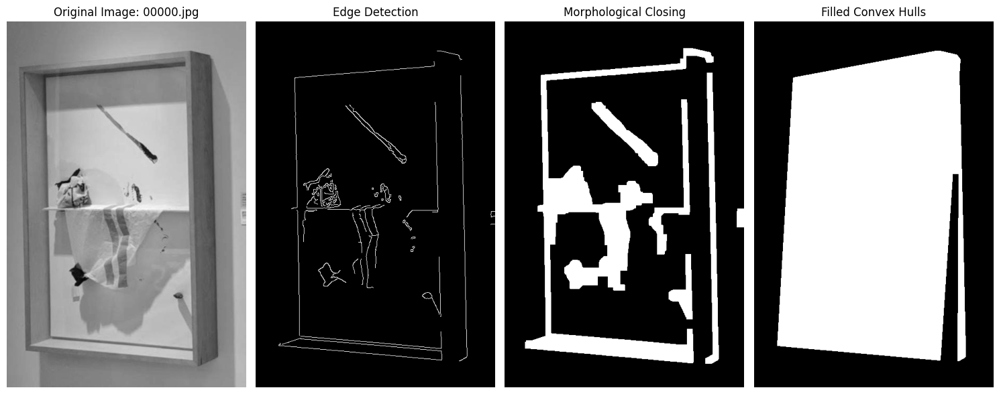

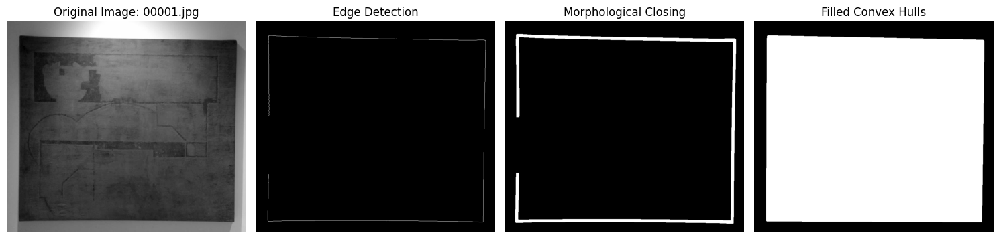

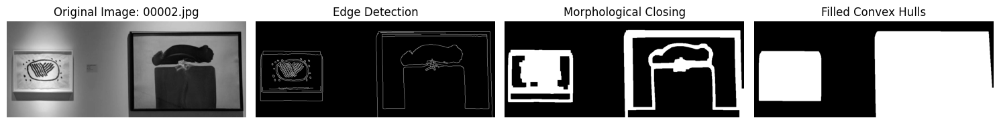

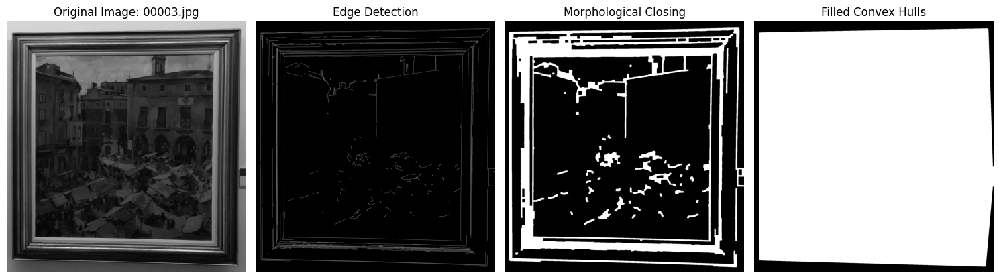

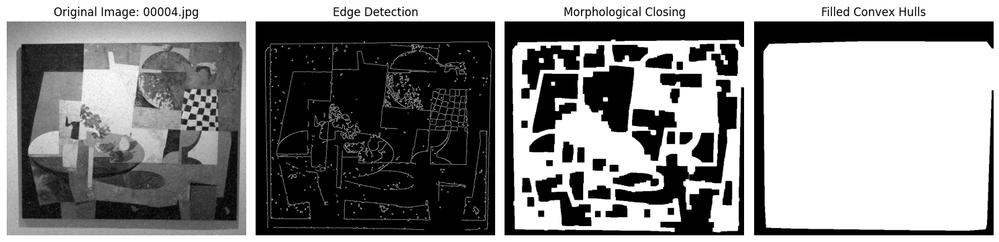

...

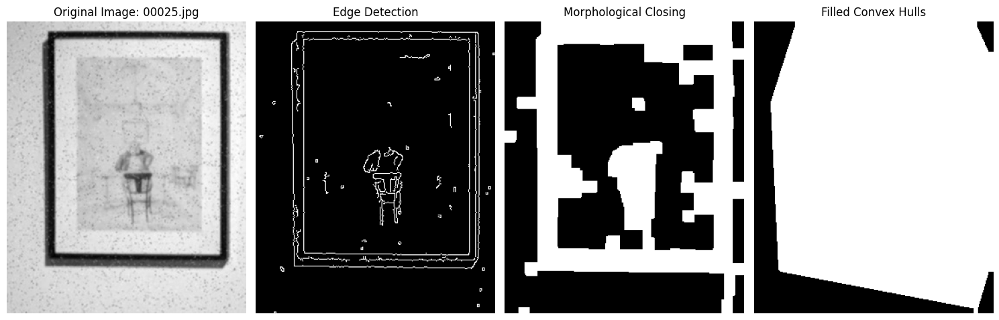

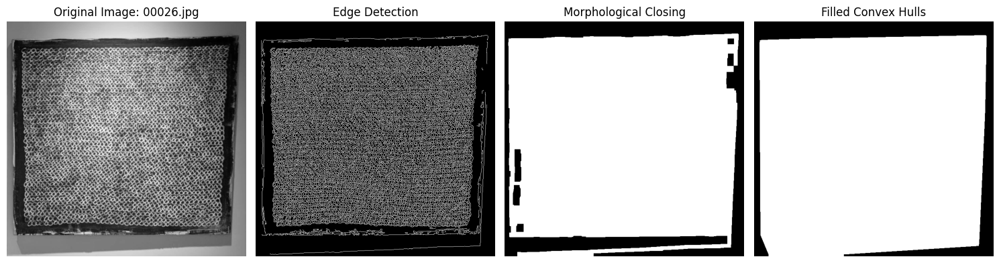

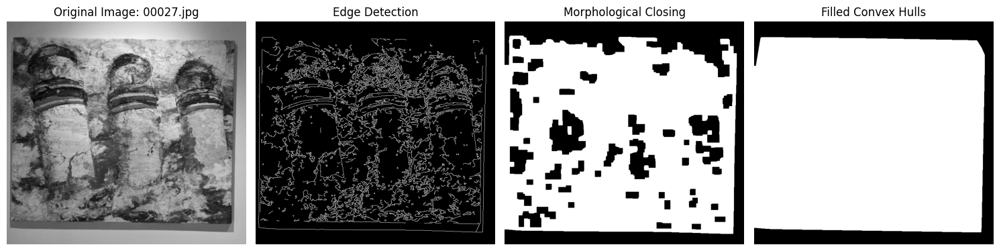

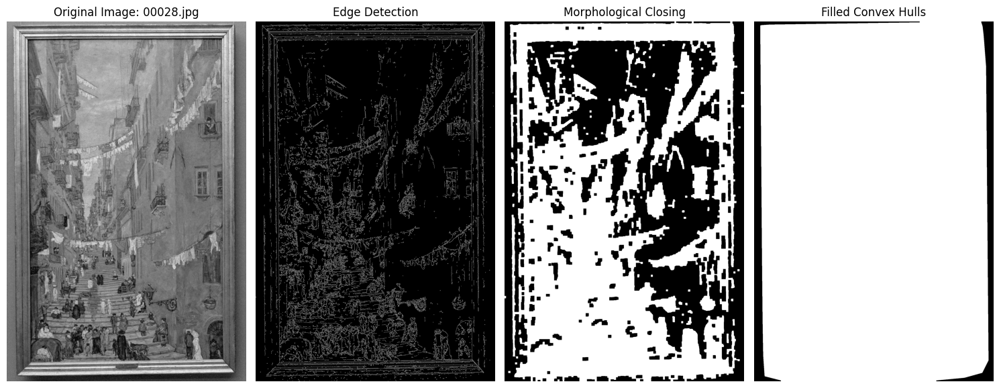

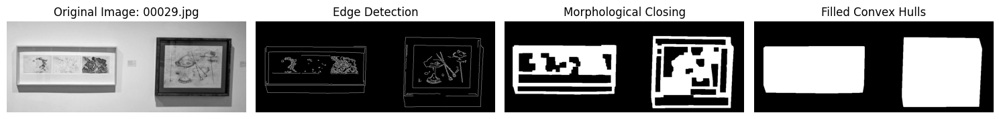

In [363]:
# Example usage: provide the path to your image directory
image_directory = 'data/denoised_1_2'  # Change this to your directory path
process_directory_images(image_directory)

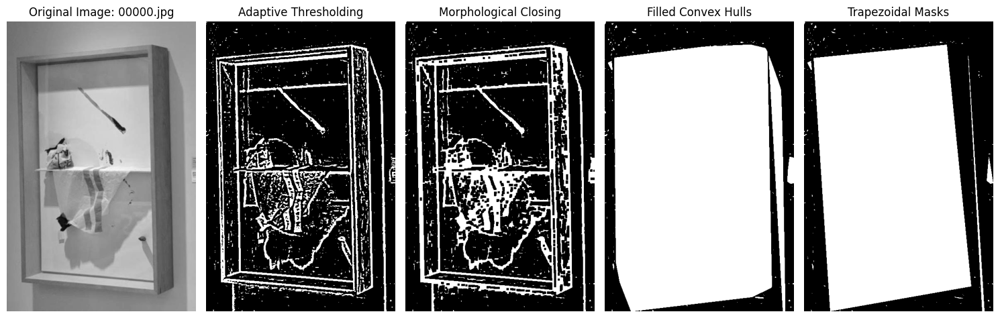

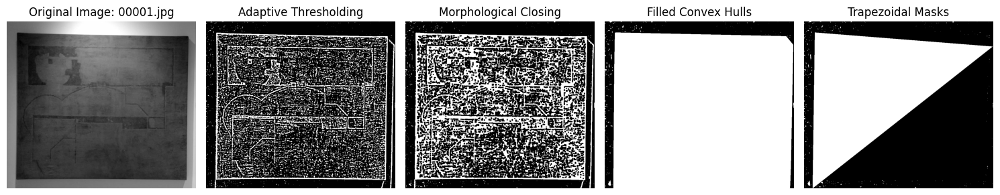

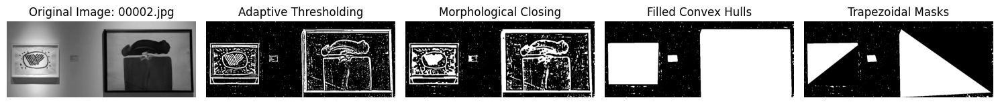

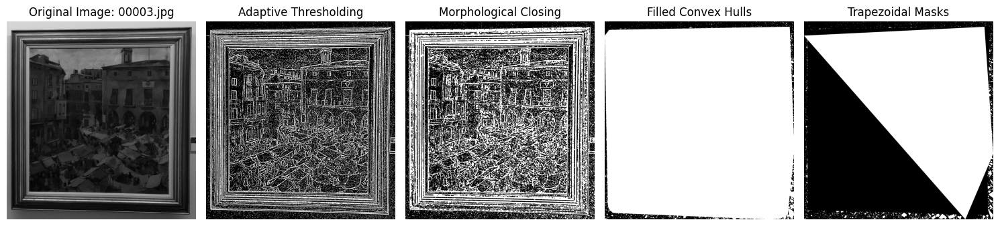

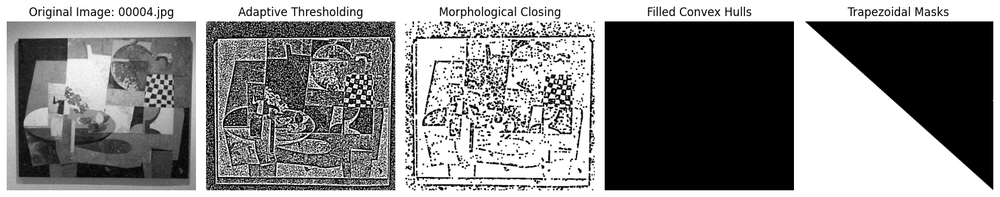

...

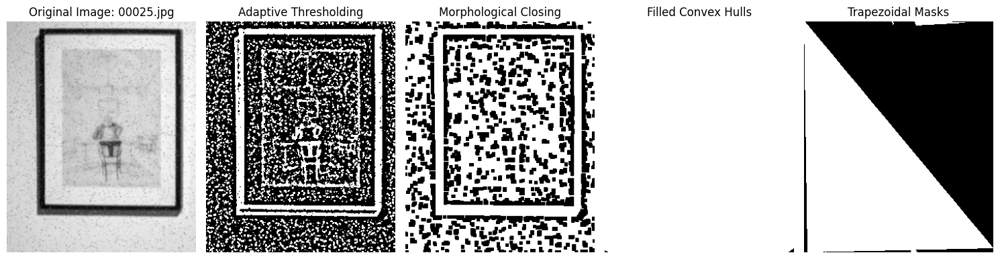

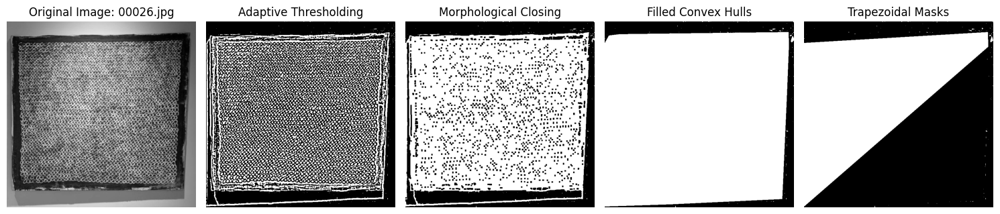

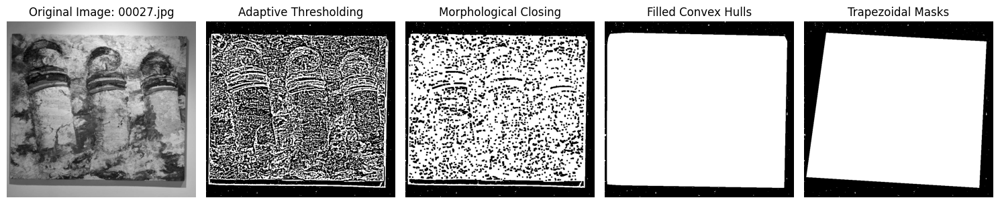

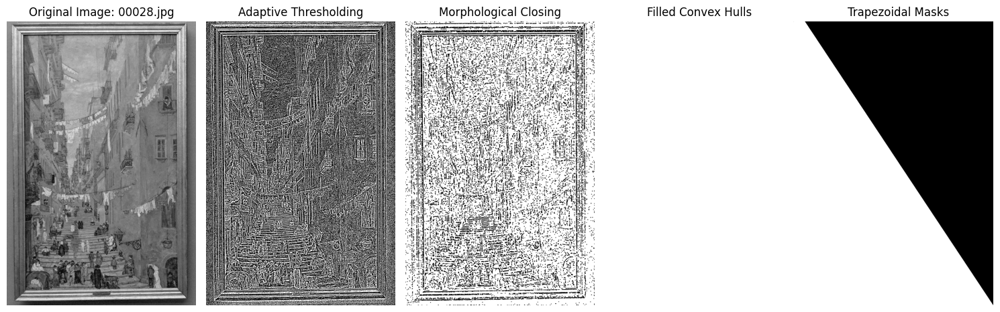

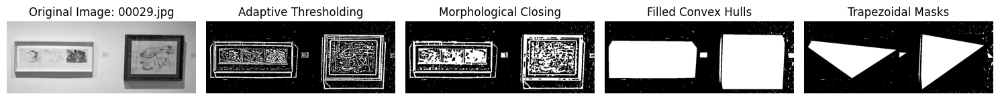

In [158]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt

def compute_border_thresholds(image, border_size=10):
    top_border = image[:border_size, :]
    bottom_border = image[-border_size:, :]
    left_border = image[:, :border_size]
    right_border = image[:, -border_size:]

    border_pixels = np.concatenate((top_border.flatten(), 
                                    bottom_border.flatten(), 
                                    left_border.flatten(), 
                                    right_border.flatten()))

    mean_intensity = np.mean(border_pixels)
    std_intensity = np.std(border_pixels)

    threshold1 = mean_intensity
    threshold2 = mean_intensity + 1.5 * std_intensity

    return threshold1, threshold2

def adaptive_threshold(image):
    # Convert to grayscale if necessary
    if len(image.shape) == 3:
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    else:
        gray = image

    # Apply adaptive mean thresholding
    thresh = cv2.adaptiveThreshold(
        gray,
        255,
        cv2.ADAPTIVE_THRESH_MEAN_C,
        cv2.THRESH_BINARY,
        blockSize=11,
        C=2
    )
    
    return cv2.bitwise_not(thresh)

def fill_artworks_with_convex_hull(edges):
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5))
    closed = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, kernel)

    contours, _ = cv2.findContours(closed, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    mask = np.zeros_like(edges)

    for contour in contours:
        if contour.size > 0:
            convex_hull = cv2.convexHull(contour)
            cv2.drawContours(mask, [convex_hull], -1, 255, thickness=cv2.FILLED)

    return mask, contours

def find_extreme_points(contour):
    leftmost = tuple(contour[contour[:, :, 0].argmin()][0])
    rightmost = tuple(contour[contour[:, :, 0].argmax()][0])
    topmost = tuple(contour[contour[:, :, 1].argmin()][0])
    bottommost = tuple(contour[contour[:, :, 1].argmax()][0])
    
    return leftmost, rightmost, topmost, bottommost

def create_trapezoidal_mask(contours, image_shape):
    trapezoidal_mask = np.zeros(image_shape, dtype=np.uint8)
    
    for contour in contours:
        extreme_points = find_extreme_points(contour)

        # Define trapezoidal points based on extreme points
        leftmost, rightmost, topmost, bottommost = extreme_points

        # Create trapezoidal shape
        trapezoid = np.array([leftmost, topmost, rightmost, bottommost], dtype=np.int32)

        # Fill the trapezoid in the mask
        cv2.fillConvexPoly(trapezoidal_mask, trapezoid, 255)

    return trapezoidal_mask

def process_directory_images(directory_path):
    for filename in os.listdir(directory_path):
        image_path = os.path.join(directory_path, filename)
        
        if filename.lower().endswith('.jpg'):
            image = cv2.imread(image_path)

            if image is None:
                print(f"Failed to load image at {image_path}")
                continue

            # Use adaptive thresholding for edge detection
            edges = adaptive_threshold(image)
            mask, contours = fill_artworks_with_convex_hull(edges)
            trapezoidal_mask = create_trapezoidal_mask(contours, image.shape[:2])

            image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

            plt.figure(figsize=(15, 10))

            plt.subplot(1, 5, 1)
            plt.imshow(image_gray, cmap="gray")
            plt.title(f"Original Image: {filename}")
            plt.axis("off")

            plt.subplot(1, 5, 2)
            plt.imshow(edges, cmap="gray")
            plt.title("Adaptive Thresholding")
            plt.axis("off")

            plt.subplot(1, 5, 3)
            closed = cv2.morphologyEx(edges, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_RECT, (5, 5)))
            plt.imshow(closed, cmap="gray")
            plt.title("Morphological Closing")
            plt.axis("off")

            plt.subplot(1, 5, 4)
            plt.imshow(mask, cmap="gray")
            plt.title("Filled Convex Hulls")
            plt.axis("off")

            plt.subplot(1, 5, 5)
            plt.imshow(trapezoidal_mask, cmap="gray")
            plt.title("Trapezoidal Masks")
            plt.axis("off")

            plt.tight_layout()
            plt.show()

# Example usage
process_directory_images('data/denoised_1_2')  # Change this to your directory path
